In [7]:
import pandas as pd

In [24]:
data = pd.read_csv("C:/Users/HP/Desktop/df_ML/datasetfines.csv")
numeric_columns = ['Широта1', 'Долгота1', 'Широта2', 'Долгота2']
for col in numeric_columns:
    data[col] = pd.to_numeric(data[col].astype(str).str.replace(',', '.'), errors='coerce')
data.head()

,Период,ДатаНачала,ДатаОкончания,Широта1,Долгота1,Широта2,Долгота2,УчастокДороги,sec
0,27.12.2022 0:00,27.12.2022 14:01,27.12.2022 15:31,55.796806,49.124533,55.796750,49.124521,110,24704
1,27.12.2022 0:00,27.12.2022 14:01,27.12.2022 14:44,55.777253,49.141678,55.777269,49.141649,140,60274
2,27.12.2022 0:00,27.12.2022 14:01,27.12.2022 14:30,55.777133,49.141931,55.777121,49.142008,140,2893
3,27.12.2022 0:00,27.12.2022 14:01,27.12.2022 14:30,55.777095,49.142016,55.777061,49.142131,140,534
4,27.12.2022 0:00,27.12.2022 14:03,27.12.2022 14:56,55.797693,49.133654,55.797690,49.133693,112,70546


In [11]:
#Нахождение координат с наибольшим количеством нарушений
import folium
max_violations_coord = data.loc[data['УчастокДороги'].idxmax(), ['Широта1', 'Долгота1']]
my_map = folium.Map(location=[max_violations_coord['Широта1'], max_violations_coord['Долгота1']], zoom_start=12)

In [15]:
#Информация о месте с наибольшим количеством нарушений
max_violations_row = data.loc[data['УчастокДороги'].idxmax()]
print("Информация о месте с наибольшим количеством нарушений:")
print(max_violations_row[['Широта1', 'Долгота1', 'УчастокДороги']])

Информация о месте с наибольшим количеством нарушений:
Широта1          55.831161
Долгота1         49.103955
УчастокДороги          196
Name: 89868, dtype: object


In [25]:
#Создаем базовой карты
from folium.plugins import HeatMap
heat_data = [[row['Широта1'], row['Долгота1'], row['УчастокДороги']] for _, row in data.iterrows()]
HeatMap(heat_data).add_to(my_map)
my_map

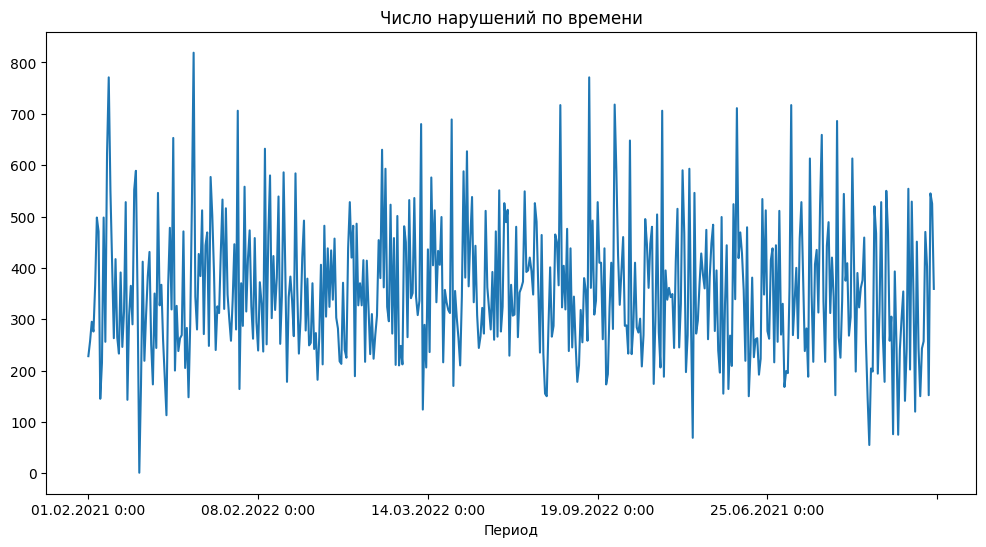

In [26]:
#Построение графика для анализа временных трендов
import matplotlib.pyplot as plt
data['Период'] = pd.to_datetime(data['Период'])
violations_by_period = data.groupby('Период').size()
plt.figure(figsize=(12, 6))
violations_by_period.plot(title='Число нарушений по времени')
plt.show()

In [28]:
#Обзор данных
print(data.head())
print(data.info())

            Период        ДатаНачала     ДатаОкончания    Широта1   Долгота1  \
0  27.12.2022 0:00  27.12.2022 14:01  27.12.2022 15:31  55.796806  49.124533   
1  27.12.2022 0:00  27.12.2022 14:01  27.12.2022 14:44  55.777253  49.141678   
2  27.12.2022 0:00  27.12.2022 14:01  27.12.2022 14:30  55.777133  49.141931   
3  27.12.2022 0:00  27.12.2022 14:01  27.12.2022 14:30  55.777095  49.142016   
4  27.12.2022 0:00  27.12.2022 14:03  27.12.2022 14:56  55.797693  49.133654   

     Широта2   Долгота2  УчастокДороги    sec  
0  55.796750  49.124521            110  24704  
1  55.777269  49.141649            140  60274  
2  55.777121  49.142008            140   2893  
3  55.777061  49.142131            140    534  
4  55.797690  49.133693            112  70546  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 177845 entries, 0 to 177844
Data columns (total 9 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Период         177845 non-

In [27]:
#Статистика
print(data.describe())

             Широта1       Долгота1        Широта2       Долгота2  \
count  177845.000000  177845.000000  177845.000000  177845.000000   
mean       55.793122      49.129278      55.793122      49.129278   
std         0.109053       0.110227       0.109053       0.110227   
min        49.211452      49.089957      49.211452      49.089966   
25%        55.786604      49.115280      55.786604      49.115280   
50%        55.791352      49.125009      55.791349      49.125014   
75%        55.798761      49.137822      55.798761      49.137821   
max        55.831236      55.750917      55.831201      55.750917   

       УчастокДороги            sec  
count  177845.000000  177845.000000  
mean      137.891681   47408.554826  
std        23.049412   27515.504906  
min       101.000000       0.000000  
25%       116.000000   23551.000000  
50%       137.000000   47131.000000  
75%       156.000000   71043.000000  
max       196.000000   97641.000000  


SyntaxError: invalid syntax. Perhaps you forgot a comma? (2096351939.py, line 1)